<a href="https://colab.research.google.com/github/Saihil30/FIFA-20-Overall-Score-Predictor/blob/main/FIFA_20_Over_Predictor_all_Score.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np 
import seaborn as sns
%matplotlib inline 
plt.style.use('ggplot')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

Now to import the data set using pandas

In [2]:
df = pd.read_csv('/content/players_20.csv')
df.head(5)

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,loaned_from,joined,contract_valid_until,nation_position,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,"#Dribbler, #Distance Shooter, #Crosser, #FK Sp...",RW,10.0,NaN,2004-07-01,2021.0,NaN,NaN,87.0,92.0,92.0,96.0,39.0,66.0,NaN,NaN,NaN,NaN,NaN,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2
1,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,34.0,1985-02-05,187.0,83.0,Portugal,Juventus,93.0,93.0,58500000.0,405000.0,"ST, LW",Right,5.0,4.0,5.0,High/Low,C. Ronaldo,Yes,96500000.0,"#Speedster, #Dribbler, #Distance Shooter, #Acr...",LW,7.0,NaN,2018-07-10,2022.0,LS,7.0,90.0,93.0,82.0,89.0,35.0,78.0,NaN,NaN,NaN,NaN,NaN,NaN,"Long Throw-in, Selfish, Argues with Officials,...",84.0,94.0,89.0,83.0,87.0,89.0,81.0,76.0,77.0,92.0,89.0,91.0,87.0,96.0,71.0,95.0,95.0,85.0,78.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,32.0,24.0,7.0,11.0,15.0,14.0,11.0,91+3,91+3,91+3,89+3,90+3,90+3,90+3,89+3,88+3,88+3,88+3,88+3,81+3,81+3,81+3,88+3,65+3,61+3,61+3,61+3,65+3,61+3,53+3,53+3,53+3,61+3
2,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Junior,27.0,1992-02-05,175.0,68.0,Brazil,Paris Saint-Germain,92.0,92.0,105500000.0,290000.0,"LW, CAM",Right,5.0,5.0,5.0,High/Medium,Neymar,Yes,195200000.0,"#Speedster, #Dribbler, #Playmaker , #Crosser,...",CAM,10.0,NaN,2017-08-03,2022.0,LW,10.0,91.0,85.0,87.0,95.0,32.0,58.0,NaN,NaN,NaN,NaN,NaN,NaN,"Power Free-Kick, Injury Free, Selfish, Early C...",87.0,87.0,62.0,87.0,87.0,96.0,88.0,87.0,81.0,95.0,94.0,89.0,96.0,92.0,84.0,80.0,61.0,81.0,49.0,84.0,51.0,36.0,87.0,90.0,90.0,94.0,27.0,26.0,29.0,9.0,9.0,15.0,15.0,11.0,84+3,84+3,84+3,90+3,89+3,89+3,89+3,90+3,90+3,90+3,90+3,89+3,82+3,82+3,82+3,89+3,66+3,61+3,61+3,61+3,66+3,61+3,46+3,46+3,46+3,61+3
3,200389,https://sofifa.com/player/200389/jan-oblak/20/...,J. Oblak,Jan Oblak,26.0,1993-01-07,188.0,87.0,Slovenia,Atlético Madrid,91.0,93.0,77500000.0,125000.0,GK,Right,3.0,3.0,1.0,Medium/Medium,Normal,Yes,164700000.0,NaN,GK,13.0,NaN,2014-07-16,2023.0,GK,1.0,NaN,NaN,NaN,NaN,NaN,NaN,87.0,92.0,78.0,89.0,52.0,90.0,"Flair, Acrobatic Clearance",13.0,11.0,15.0,43.0,13.0,12.0,13.0,14.0,40.0,30.0,43.0,60.0,67.0,88.0,49.0,59.0,78.0,41.0,78.0,12.0,34.0,19.0,11.0,65.0,11.0,68.0,27.0,12.0,18.0,87.0,92.0,78.0,90.0,89.0,NaN,NaN,

In [3]:
df.describe()

,sofifa_id,age,height_cm,weight_kg,overall,potential,value_eur,wage_eur,international_reputation,weak_foot,skill_moves,release_clause_eur,team_jersey_number,contract_valid_until,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
count,10881.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,1.088000e+04,10880.000000,10880.000000,10880.000000,10880.000000,1.001900e+04,10696.000000,10696.000000,1042.000000,9858.000000,9858.000000,9858.000000,9858.000000,9858.000000,9858.000000,1022.000000,1022.000000,1022.000000,1022.000000,1022.000000,1022.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000,10880.000000
mean,210914.965628,26.826379,181.519577,76.032169,70.709007,73.909926,3.956413e+06,14658.823529,1.172794,3.040533,2.577206,7.626033e+06,17.814697,2021.227375,12.074856,68.740515,56.662102,61.693041,66.295597,55.111483,68.326638,71.250489,68.407045,66.573386,72.587084,41.943249,69.639922,54.461673,49.922978,56.301654,63.595312,47.298713,60.118658,52.371507,47.295404,57.699449,63.464338,66.066636,66.338787,65.964246,66.862776,64.710202,63.245312,67.166912,67.048346,68.462316,52.358640,60.564246,50.901011,54.629688,58.144393,51.977574,64.146048,51.014338,51.279320,48.766176,16.268658,16.059191,15.893290,16.153952,16.401930
std,27779.341698,4.192459,6.794786,7.087939,4.622238,5.413364,6.857800e+06,26418.704209,0.478141,0.682205,0.801641,1.362947e+07,15.764604,1.301958,6.717303,12.120469,13.580519,9.080363,9.420592,16.742815,8.569052,5.374503,5.367281,6.463186,5.601328,9.362684,5.580108,18.299768,19.643433,17.342412,13.418536,18.154668,18.345656,18.770231,18.108122,14.269307,15.652280,14.707844,14.382198,14.389558,6.756096,14.272779,12.183926,12.021899,15.023292,11.725467,19.129336,16.884513,20.982421,19.580655,13.580583,15.708358,9.827041,20.380483,22.135163,22.031020,18.045351,17.203240,16.722334,17.577711,18.421546
min,768.000000,16.000000,156.000000,52.000000,65.000000,65.000000,0.000000e+00,0.000000,1.000000,1.000000,1.000000,6.300000e+04,1.000000,2019.000000,1.000000,25.000000,15.000000,30.000000,31.000000,17.000000,31.000000,54.000000,51.000000,40.000000,62.000000,13.000000,55.000000,6.000000,2.000000,5.000000,8.000000,4.000000,4.000000,6.000000,4.000000,9.000000,5.000000,12.000000,13.000000,14.000000,35.000000,12.000000,15.000000,23.000000,13.000000,20.000000,4.000000,11.000000,3.000000,2.000000,9.000000,9.000000,12.000000,5.000000,6.000000,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,196615.000000,24.000000,177.000000,71.000000,67.000000,70.000000,8.000000e+05,3000.000000,1.000000,3.000000,2.000000,1.400000e+06,7.000000,2020.000000,6.000000,62.000000,47.000000,56.000000,62.000000,39.000000,63.000000,67.000000,65.000000,62.000000,68.000000,36.000000,66.000000,44.000000,35.000000,49.000000,61.000000,34.000000,56.000000,40.000000,34.000000,51.000000,62.000000,58.000000,59.000000,5

In [4]:
df.info

<bound method DataFrame.info of        sofifa_id                                         player_url  \
0         158023  https://sofifa.com/player/158023/lionel-messi/...   
1          20801  https://sofifa.com/player/20801/c-ronaldo-dos-...   
2         190871  https://sofifa.com/player/190871/neymar-da-sil...   
3         200389  https://sofifa.com/player/200389/jan-oblak/20/...   
4         183277  https://sofifa.com/player/183277/eden-hazard/2...   
5         192985  https://sofifa.com/player/192985/kevin-de-bruy...   
6         192448  https://sofifa.com/player/192448/marc-andre-te...   
7         203376  https://sofifa.com/player/203376/virgil-van-di...   
8         177003  https://sofifa.com/player/177003/luka-modric/2...   
9         209331  https://sofifa.com/player/209331/mohamed-salah...   
10        231747  https://sofifa.com/player/231747/kylian-mbappe...   
11        201024  https://sofifa.com/player/201024/kalidou-kouli...   
12        202126  https://sofifa.com/player/2

In [5]:
(df.isnull().sum()/len(df))*100

sofifa_id                      0.000000
player_url                     0.000000
short_name                     0.009190
long_name                      0.009190
age                            0.009190
dob                            0.009190
height_cm                      0.009190
weight_kg                      0.009190
nationality                    0.009190
club                           0.009190
overall                        0.009190
potential                      0.009190
value_eur                      0.009190
wage_eur                       0.009190
player_positions               0.009190
preferred_foot                 0.009190
international_reputation       0.009190
weak_foot                      0.009190
skill_moves                    0.009190
work_rate                      0.009190
body_type                      0.009190
real_face                      0.009190
release_clause_eur             7.922066
player_tags                   87.684955
team_position                  1.700211


# Initial Data Cleaning

After taking look at the data we can see that there are many null values, as an initial cleaning we will remove those columns that contain a lot of null values

In [6]:
# columns such as player_tags, loaned_from, nation_position, nation_jersey_number, gk_diving,gk_handling,gk_kicking, gk_reflexes, gk_positioning will be removed as more than %90 of the column is missing values
# we will also create a new data frame (df1) whilst removing columns with many null values

In [7]:
df1 = df.copy()

In [8]:
df1 = df1.drop(['loaned_from','nation_position','nation_jersey_number','nation_jersey_number','gk_diving','gk_handling','gk_kicking','gk_reflexes','gk_positioning'],  axis=1 )

In [9]:
df1.shape

(10881, 96)

In [10]:
df.head(1)

,sofifa_id,player_url,short_name,long_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,loaned_from,joined,contract_valid_until,nation_position,nation_jersey_number,pace,shooting,passing,dribbling,defending,physic,gk_diving,gk_handling,gk_kicking,gk_reflexes,gk_speed,gk_positioning,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,"#Dribbler, #Distance Shooter, #Crosser, #FK Sp...",RW,10.0,NaN,2004-07-01,2021.0,NaN,NaN,87.0,92.0,92.0,96.0,39.0,66.0,NaN,NaN,NaN,NaN,NaN,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2


in determining the overall players rating we will not need the player url, sofifa id aswell as the player long name so i will also remove those columns from the data set.

In [11]:
df1 = df1.drop(['sofifa_id', 'player_url', 'long_name',], axis=1)

In [12]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,"#Dribbler, #Distance Shooter, #Crosser, #FK Sp...",RW,10.0,2004-07-01,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89+2,89+2,89+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,93+2,92+2,87+2,87+2,87+2,92+2,68+2,66+2,66+2,66+2,68+2,63+2,52+2,52+2,52+2,63+2


In [13]:
# lets remove the '+2' values on the positions for the players 
positions = ['ls',	'st',	'rs',	'lw',	'lf',	'cf',	'rf',	'rw',	'lam',	'cam',	'ram',	'lm',	'lcm',	'cm',	'rcm',	'rm',	'lwb',	'ldm',	'cdm',	'rdm',	'rwb',	'lb',	'lcb',	'cb',	'rcb',	'rb',	]

In [14]:
for col in positions:
  df1[col] = df1[col].apply(lambda x: str(x).split('+')[0])

In [15]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,player_tags,team_position,team_jersey_number,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,"#Dribbler, #Distance Shooter, #Crosser, #FK Sp...",RW,10.0,2004-07-01,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89,89,89,93,93,93,93,93,93,93,93,92,87,87,87,92,68,66,66,66,68,63,52,52,52,63


as we are predicting the overall score of a player, i believe it will be predicted on thier stats and not, player tags, team jersey number

In [16]:
df1 = df1.drop(['player_tags','team_jersey_number'],axis=1)

In [17]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,RW,2004-07-01,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89,89,89,93,93,93,93,93,93,93,93,92,87,87,87,92,68,66,66,66,68,63,52,52,52,63


In [18]:
df1.joined.unique()

array(['2004-07-01', '2018-07-10', '2017-08-03', ..., '2019-03-15',
       '2019-04-02', '2016-05-31'], dtype=object)

lets work out how long the player has been playing for, this data is from 2020 so we will subtract the start of the players carrer from 2020

In [19]:
# extract the year from the joined column

In [20]:
df1.joined = df1.joined.apply(lambda x:str(x).split('-')[0])

In [21]:
df1.joined.unique()

array(['2004', '2018', '2017', '2014', '2019', '2015', '2012', '2010',
       '2011', '2016', '2005', '2008', '2013', '2009', 'nan', '2007',
       '2002', '2003', '2006', '2001', '2000', '1998'], dtype=object)

In [22]:
df1['joined'] = df1['joined'].apply(lambda x: x.replace('nan', '2020'))

In [23]:
df1.joined.unique()

array(['2004', '2018', '2017', '2014', '2019', '2015', '2012', '2010',
       '2011', '2016', '2005', '2008', '2013', '2009', '2020', '2007',
       '2002', '2003', '2006', '2001', '2000', '1998'], dtype=object)

In [24]:
df1.joined = df1.joined.astype(int)

now to add a new column labelled 'Years of experience'

In [25]:
df1['Years of experience'] = 2020 - df1.joined

In [26]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,joined,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,Years of experience
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,RW,2004,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89,89,89,93,93,93,93,93,93,93,93,92,87,87,87,92,68,66,66,66,68,63,52,52,52,63,16


In [27]:
df1.drop('joined',axis=1 , inplace = True)

In [28]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,Years of experience
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,RW,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,89,89,89,93,93,93,93,93,93,93,93,92,87,87,87,92,68,66,66,66,68,63,52,52,52,63,16


lets now review the workout 

In [29]:
df1['work_rate'].value_counts()

Medium/Medium    4973
High/Medium      2248
Medium/High      1253
High/High         809
Medium/Low        552
High/Low          479
Low/High          289
Low/Medium        262
Low/Low            15
Name: work_rate, dtype: int64

As our target varaible as 'Overall' I do not believe the other positions the player can play will be extremely useful, as we want to build our predictive model on player playing in their OWN positions. For example we will only want to build a model using Lionel Messi's data when he is playing in RF which is his intented position to maximize his overall stat. Therefore, we can drop them

In [30]:
# drop the uneeded position columns
df1.drop(['ls',	'st',	'rs',	'lw',	'lf',	'cf',	'rf',	'rw',	'lam',	'cam',	'ram',	'lm',	'lcm',	'cm',	'rcm',	'rm',	'lwb',	'ldm',	'cdm',	'rdm',	'rwb',	'lb',	'lcb',	'cb',	'rcb',	'rb'],axis=1, inplace=True)

In [31]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,Years of experience
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,RW,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,16


In [32]:
df1['body_type'].value_counts()

Normal                 6661
Lean                   3499
Stocky                  713
Messi                     1
C. Ronaldo                1
Neymar                    1
PLAYER_BODY_TYPE_25       1
Courtois                  1
Shaqiri                   1
Akinfenwa                 1
Name: body_type, dtype: int64

player body type 25 seems to look like a mistake

In [33]:
df1 = df1.loc[df1['body_type'] != 'PLAYER_BODY_TYPE_25']

In [34]:
df1['body_type'].value_counts()

Normal        6661
Lean          3499
Stocky         713
Messi            1
C. Ronaldo       1
Neymar           1
Courtois         1
Shaqiri          1
Akinfenwa        1
Name: body_type, dtype: int64

gathering information from the body type, we can see that Messi, Ronaldo, Neymar, Courtois, Shaqiri and Akinfenwa have unique body types -  this could indicate some difference in their overall rating due to their body type

Lets now do some exploritory data analysis

# Exploritory Data Analysis 

We can split our data into categorical and numerical data when doing EDA

# Categorical Variables EDA
For Categorical data I plan to:

- Create pivot tables to see the average of variables across different categories
- Use countplots
- Figure out if what specific teams have high overall averages

In [35]:
df1.columns

Index(['short_name', 'age', 'dob', 'height_cm', 'weight_kg', 'nationality',
       'club', 'overall', 'potential', 'value_eur', 'wage_eur',
       'player_positions', 'preferred_foot', 'international_reputation',
       'weak_foot', 'skill_moves', 'work_rate', 'body_type', 'real_face',
       'release_clause_eur', 'team_position', 'contract_valid_until', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic', 'gk_speed',
       'player_traits', 'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       

In [36]:
# lets see the average overall score across our categorical variables
cat_cols = ['nationality', 'club', 'preferred_foot', 'work_rate', 'body_type', 'position']

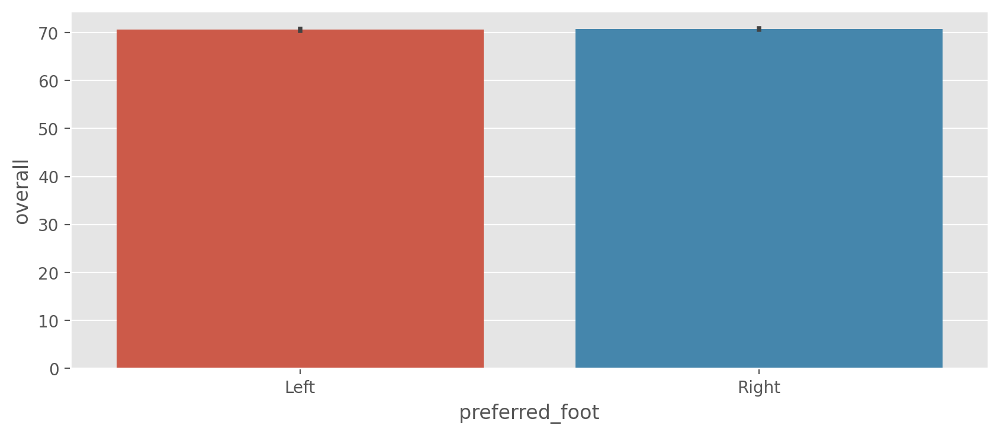

In [37]:
plt.figure(figsize=(10,4),dpi=200)
sns.barplot(data=df1, x='preferred_foot', y='overall')

In [38]:
# there seems to be an even split between right and left 

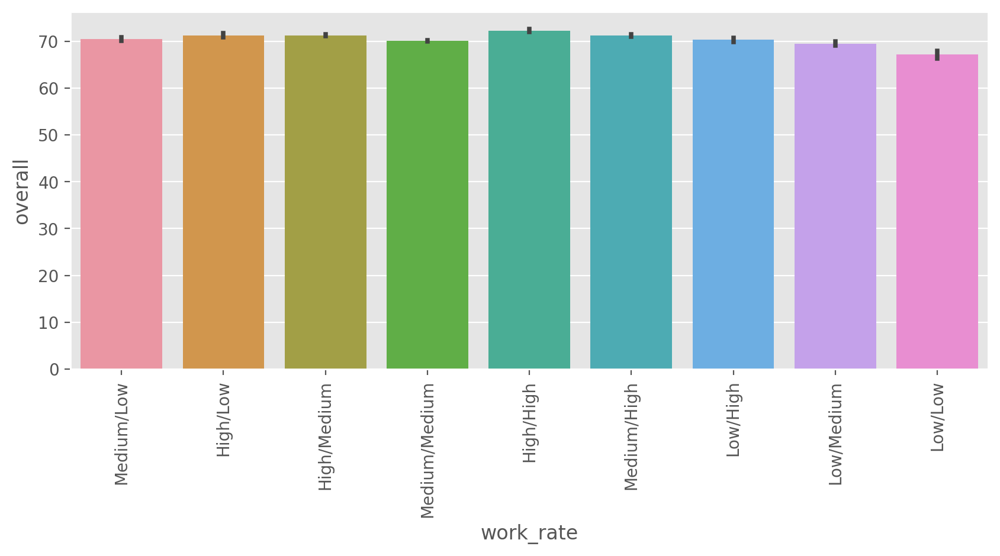

In [39]:
plt.figure(figsize=(10,4),dpi=200)
sns.barplot(data=df1, x='work_rate', y='overall')
plt.xticks(rotation=90)
plt.show()

In [40]:
# we can see using this barplot that High/High has the highest overall score, and Low/Low has the lowest score in the group

In [41]:
pd.pivot_table(data=df1, index='nationality',values='overall', aggfunc='mean').sort_values(by='overall',ascending=False)

,overall
nationality,
Tanzania,79.000000
Philippines,75.000000
Syria,74.000000
Dominican Republic,73.500000
Gabon,73.250000
Mozambique,73.250000
Uruguay,73.248227
Chad,73.000000
Central African Rep.,73.000000


Tanzania has the highest average overall score? that looks peculiar, lets investigate further 

In [42]:
df1.loc[df1['nationality'] == 'Tanzania']

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,Years of experience
645,M. Samatta,26.0,1992-12-13,183.0,80.0,Tanzania,KRC Genk,79.0,81.0,15500000.0,23000.0,ST,Right,1.0,4.0,3.0,High/High,Normal,No,24400000.0,ST,2021.0,85.0,78.0,66.0,73.0,32.0,74.0,NaN,Early Crosser,71.0,83.0,77.0,76.0,76.0,73.0,65.0,57.0,45.0,72.0,83.0,86.0,75.0,73.0,69.0,78.0,88.0,82.0,72.0,69.0,66.0,18.0,81.0,63.0,70.0,78.0,32.0,28.0,23.0,12.0,14.0,9.0,7.0,9.0,4


In [43]:
df1.loc[df1['nationality'] == 'Philippines']

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,Years of experience
1821,N. Etheridge,29.0,1990-02-07,191.0,89.0,Philippines,Cardiff City,75.0,77.0,5500000.0,21000.0,GK,Right,1.0,3.0,1.0,Medium/Medium,Stocky,Yes,10900000.0,GK,2021.0,NaN,NaN,NaN,NaN,NaN,NaN,52.0,"Flair, Swerve Pass, Acrobatic Clearance",11.0,13.0,11.0,31.0,11.0,21.0,18.0,18.0,21.0,32.0,51.0,53.0,54.0,76.0,58.0,46.0,47.0,34.0,76.0,11.0,16.0,24.0,18.0,48.0,43.0,62.0,12.0,14.0,13.0,77.0,67.0,61.0,76.0,77.0,3


what we have gathered from this information is that these countries have the highest overall players as they only have one player each, which makes the overall nationality appear to have a higher average overall score 

In [44]:
mean_pivot = pd.pivot_table(data=df1, index='nationality', values='overall', 
               aggfunc='mean').sort_values(by='overall', ascending=False)

In [45]:
count_pivot = pd.pivot_table(data=df1, index='nationality', values='overall', 
               aggfunc='count').sort_values(by='overall', ascending=False)
count_pivot = count_pivot.rename(columns = {'overall': 'overall_count'})
count_pivot

,overall_count
nationality,
Spain,820
Brazil,731
England,700
Germany,683
Argentina,674
France,613
Italy,510
Colombia,351
Netherlands,308


In [46]:
overall_pivot = pd.concat([mean_pivot, count_pivot], axis=1)
overall_pivot.sort_values(['overall_count', 'overall'], ascending=False)

,overall,overall_count
nationality,,
Spain,72.052439,820
Brazil,72.225718,731
England,69.722857,700
Germany,70.471449,683
Argentina,71.725519,674
France,71.704731,613
Italy,70.890196,510
Colombia,69.700855,351
Netherlands,70.688312,308


We now have a better representation of our overall stats weighted by the count of players per nationality. We can plot this to have a visiual representation, we can also explore if having more players from a nationality influences the overall stat

In [47]:
overall_pivot_top15 = (overall_pivot.sort_values(['overall_count', 'overall'], ascending=False)).head(15)

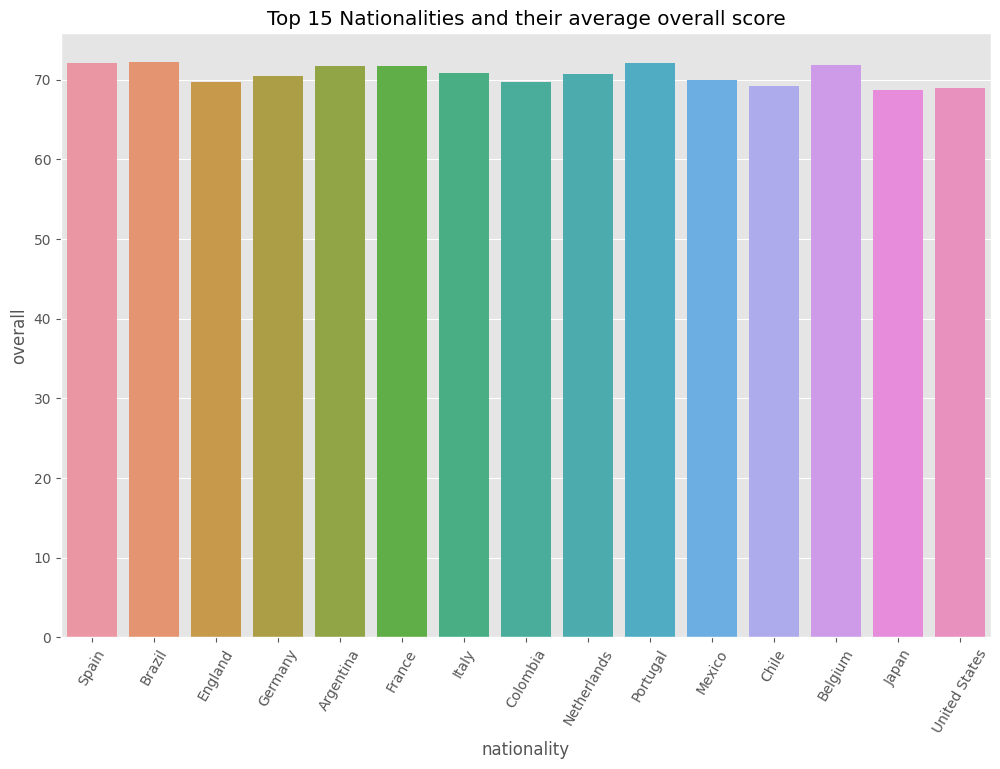

In [118]:
plt.figure(figsize=(12,8),dpi=100)
sns.barplot(data=overall_pivot_top15, x=overall_pivot_top15.index, y='overall')
plt.title('Top 15 Nationalities and their average overall score')
plt.xticks(rotation=60)
plt.show()


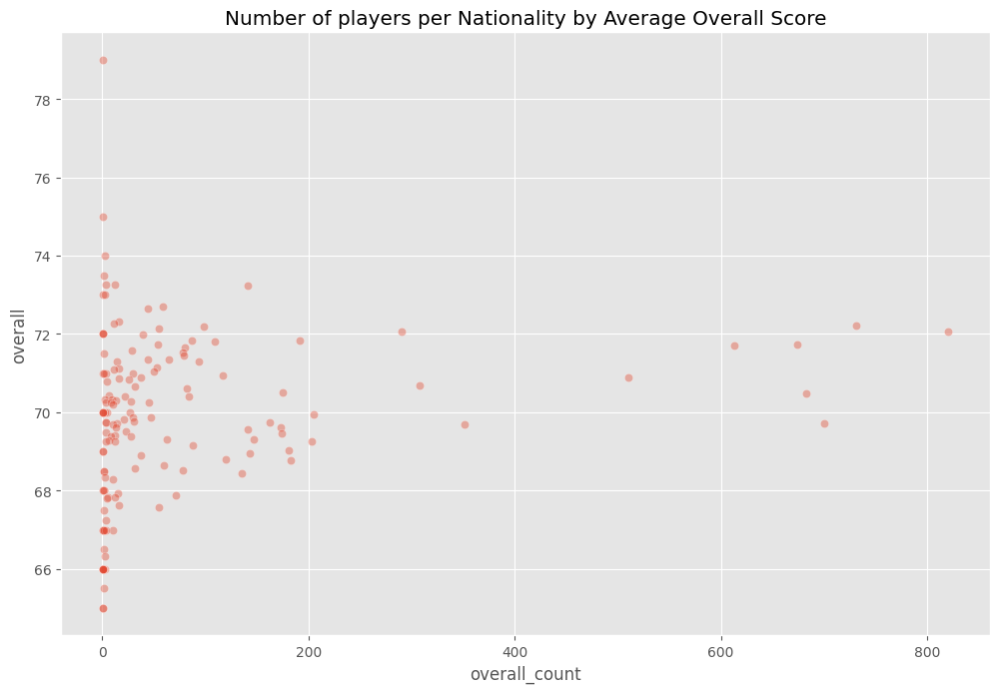

In [117]:
plt.figure(figsize=(12,8),dpi=100)
sns.scatterplot(data= overall_pivot, x='overall_count', y='overall', alpha=0.4)
plt.title('Number of players per Nationality by Average Overall Score')
plt.show()

we can see a large clusrer of nationalities with relatively low counts. 

lets explore the clubs, and in particular if being a part of a particular club lead to higher/lower overall stats 

In [50]:
pd.pivot_table(data=df1, index='club',  values='overall', aggfunc='mean').sort_values(by='overall', ascending=False).head(10)

,overall
club,
FC Bayern München,82.136364
Manchester City,81.846154
Real Madrid,80.687500
Borussia Dortmund,80.608696
Juventus,80.060606
Paris Saint-Germain,79.807692
Tottenham Hotspur,79.592593
Liverpool,79.520000
Inter,79.416667


In [51]:
df1.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,Years of experience
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,195800000.0,RW,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,95.0,70.0,92.0,88.0,97.0,93.0,94.0,92.0,96.0,91.0,84.0,93.0,95.0,95.0,86.0,68.0,75.0,68.0,94.0,48.0,40.0,94.0,94.0,75.0,96.0,33.0,37.0,26.0,6.0,11.0,15.0,14.0,8.0,16


In [52]:
pd.pivot_table(data=df1, index='club',values='Years of experience', aggfunc='mean').sort_values(by='Years of experience', ascending=False).head(15)

,Years of experience
club,
Grimsby Town,9.000000
Shanghai SIPG FC,6.384615
Hobro IK,6.333333
Shandong Luneng TaiShan FC,6.200000
Al Ain FC,5.785714
Odds BK,5.600000
Botafogo,5.500000
PFC CSKA Moscow,5.421053
Avaí FC,5.411765


In [53]:
# Looks like Grimsby Town's players have extremely high years of experience.

In [54]:
df1.loc[df1['club'] == 'Grimsby Town' ]

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,release_clause_eur,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,Years of experience
9537,J. McKeown,29.0,1989-07-24,187.0,89.0,Republic of Ireland,Grimsby Town,66.0,66.0,450000.0,3000.0,GK,Right,1.0,3.0,1.0,Medium/Medium,Normal,No,788000.0,GK,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,45.0,"Diver, Giant Throw-in",16.0,11.0,13.0,33.0,11.0,13.0,11.0,14.0,40.0,40.0,42.0,48.0,40.0,68.0,50.0,44.0,60.0,41.0,65.0,11.0,37.0,19.0,11.0,34.0,11.0,58.0,24.0,15.0,13.0,66.0,60.0,58.0,65.0,68.0,9


In [55]:
# we can now see why Grimsby Town would have shown their players have an average experience of 9 years, as there is only 1 player listed in the game from that club the average is based off of that individual

Since we are only looking at an individual players overall stats, we will ignore the impact a club can have on the overall, although in reality there is a possibility for a player to have a higher score when also surrounded with teamates that also have high stats. This could be analysed using the team chemistry - we don't have data on team chemistry so we will not use the club column in the final model

What is the average overall score by each position

In [56]:
positions_pivot = pd.pivot_table(data=df1, index='player_positions', values='overall').round(2).sort_values(by='overall',ascending=False).head(15)

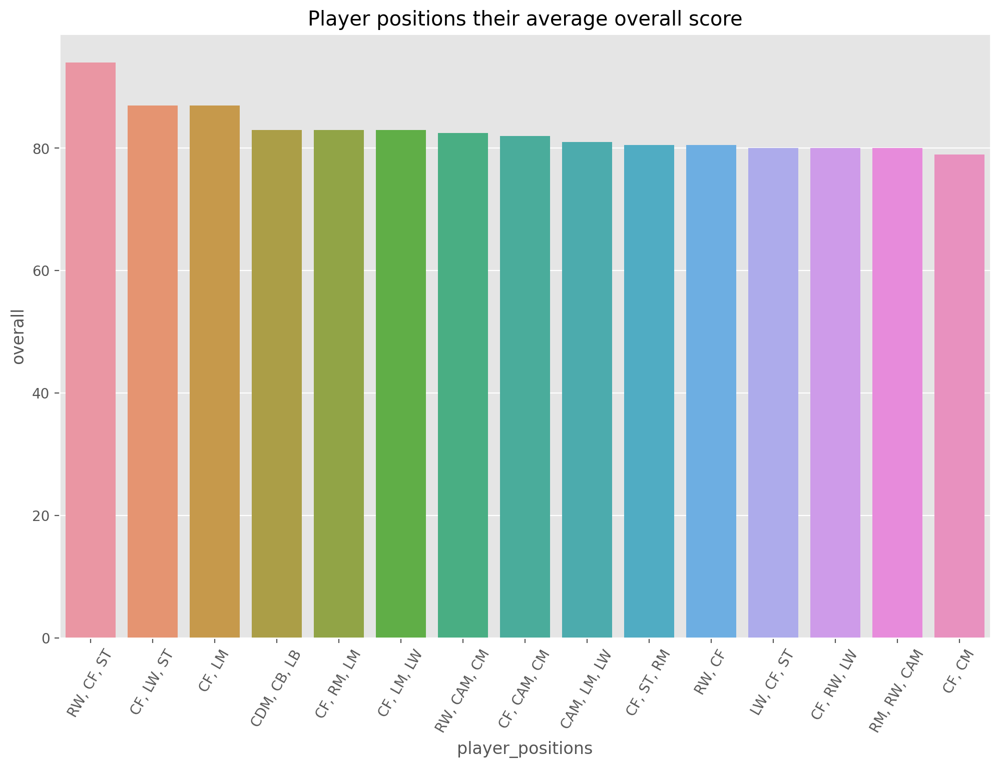

In [57]:
plt.figure(figsize=(12,8),dpi=200)
sns.barplot(data= positions_pivot, x=positions_pivot.index, y='overall')
plt.xticks(rotation=60)
plt.title('Player positions their average overall score')
plt.show()

From this graph we can gather that the ST and CF position have the highest average overall amongst any other position 

# Numerical EDA
For the numerical variables we will do the following:

Use pivot tables to see averages
Plot correlations
Plot histograms and boxplots to visualize the data distributions


In [58]:
df1.columns

Index(['short_name', 'age', 'dob', 'height_cm', 'weight_kg', 'nationality',
       'club', 'overall', 'potential', 'value_eur', 'wage_eur',
       'player_positions', 'preferred_foot', 'international_reputation',
       'weak_foot', 'skill_moves', 'work_rate', 'body_type', 'real_face',
       'release_clause_eur', 'team_position', 'contract_valid_until', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic', 'gk_speed',
       'player_traits', 'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       

In [59]:
num_cols = ['age','height_cm', 'weight_kg',
       'overall', 'potential', 'value_eur', 'wage_eur',
       'international_reputation',
       'weak_foot', 'skill_moves','release_clause_eur',
       'contract_valid_until', 'pace',
       'shooting', 'passing', 'dribbling', 'defending', 'physic', 'gk_speed',
       'attacking_crossing', 'attacking_finishing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_dribbling', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
       'movement_reactions', 'movement_balance', 'power_shot_power',
       'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
       'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking', 'defending_standing_tackle',
       'defending_sliding_tackle', 'goalkeeping_diving',
       'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes',
       'Years of experience']

In [60]:
df1[num_cols].dtypes

age                           float64
height_cm                     float64
weight_kg                     float64
overall                       float64
potential                     float64
value_eur                     float64
wage_eur                      float64
international_reputation      float64
weak_foot                     float64
skill_moves                   float64
release_clause_eur            float64
contract_valid_until          float64
pace                          float64
shooting                      float64
passing                       float64
dribbling                     float64
defending                     float64
physic                        float64
gk_speed                      float64
attacking_crossing            float64
attacking_finishing           float64
attacking_heading_accuracy    float64
attacking_short_passing       float64
attacking_volleys             float64
skill_dribbling               float64
skill_curve                   float64
skill_fk_acc

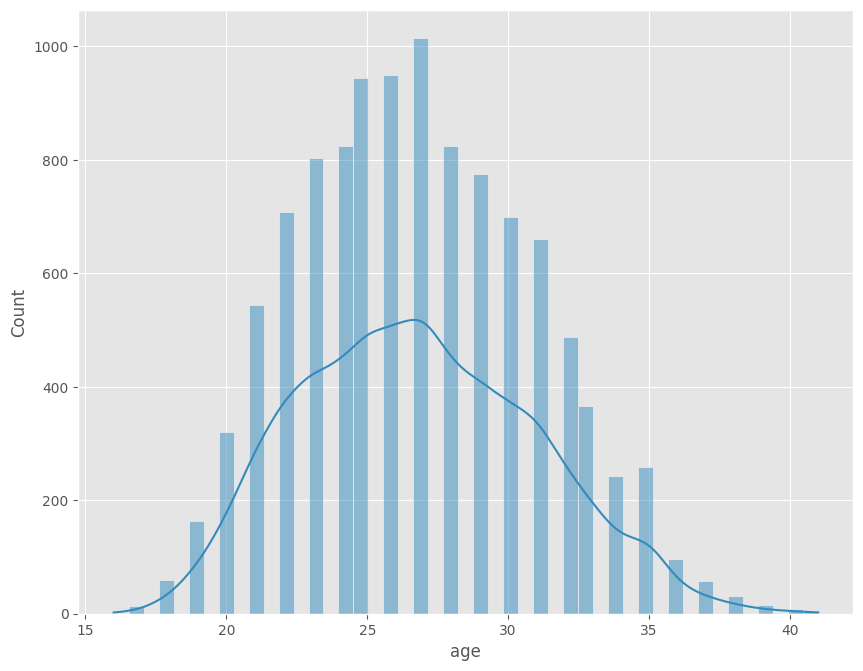

In [116]:
plt.figure(figsize=(10,8),dpi=100)
sns.histplot(data=df1, x='age', kde=True)

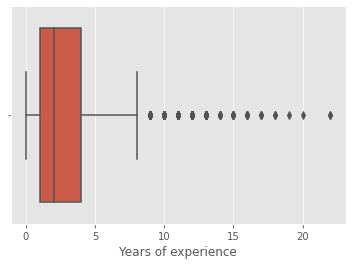

In [115]:
sns.boxplot(data=df1, x='Years of experience')

In [63]:
var = []
num_name = []
std = []
for num in num_cols:
    var.append(df1[num].var())
    std.append(df1[num].std())
    num_name.append(num)
    

In [64]:
Variance_num_cols = pd.DataFrame(zip(num_name, var, std), columns=['Name', 'Variance', 'Standard Deviation']).round(2)

In [65]:
Variance_num_cols.sort_values(by='Standard Deviation')

,Name,Variance,Standard Deviation
7,international_reputation,2.300000e-01,0.48
8,weak_foot,4.700000e-01,0.68
9,skill_moves,6.400000e-01,0.80
11,contract_valid_until,1.690000e+00,1.30
53,Years of experience,5.490000e+00,2.34
0,age,1.758000e+01,4.19
3,overall,2.133000e+01,4.62
4,potential,2.928000e+01,5.41
32,movement_reactions,4.559000e+01,6.75
1,height_cm,4.617000e+01,6.79


We can see that there is some variability in the data we can visualize our data and see if it is skewed

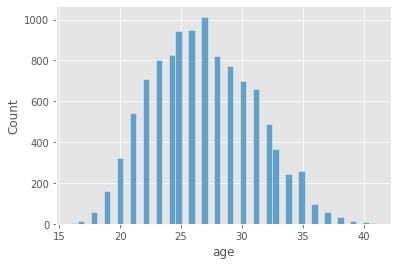

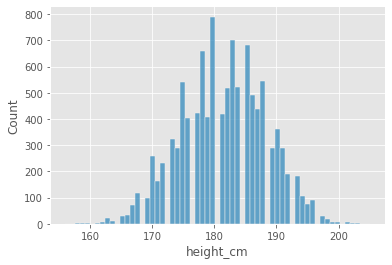

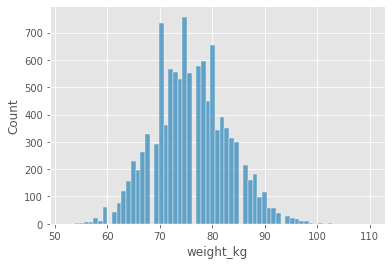

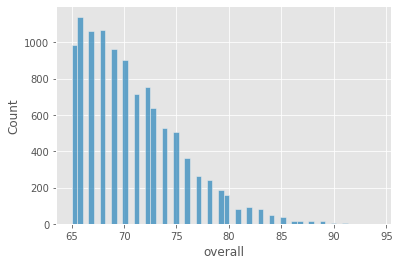

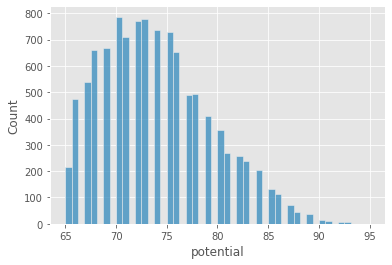

...

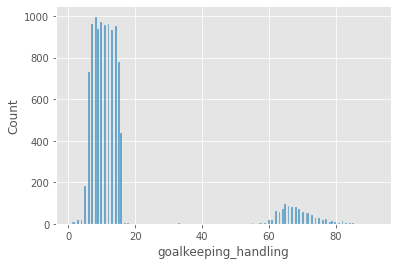

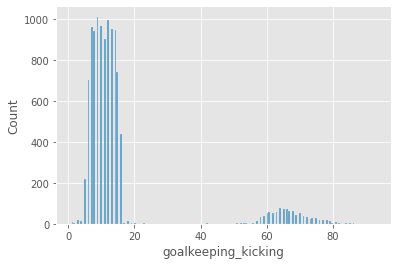

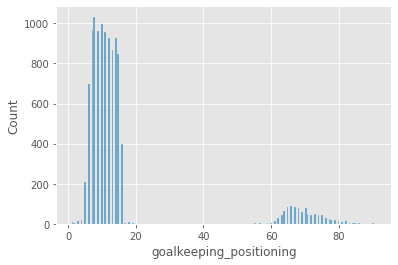

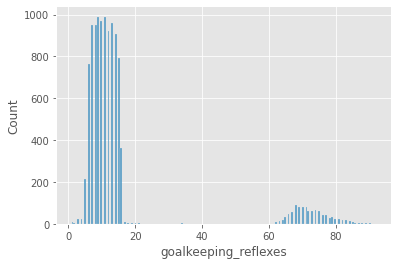

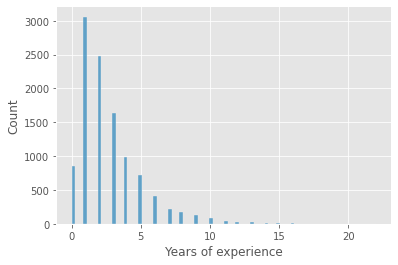

In [113]:
for num in num_cols:
    sns.histplot(data=df1,x=num)
    plt.show()

We can immediately see that the Years of experience is right skewed - we can apply log transformation to reduce skewness

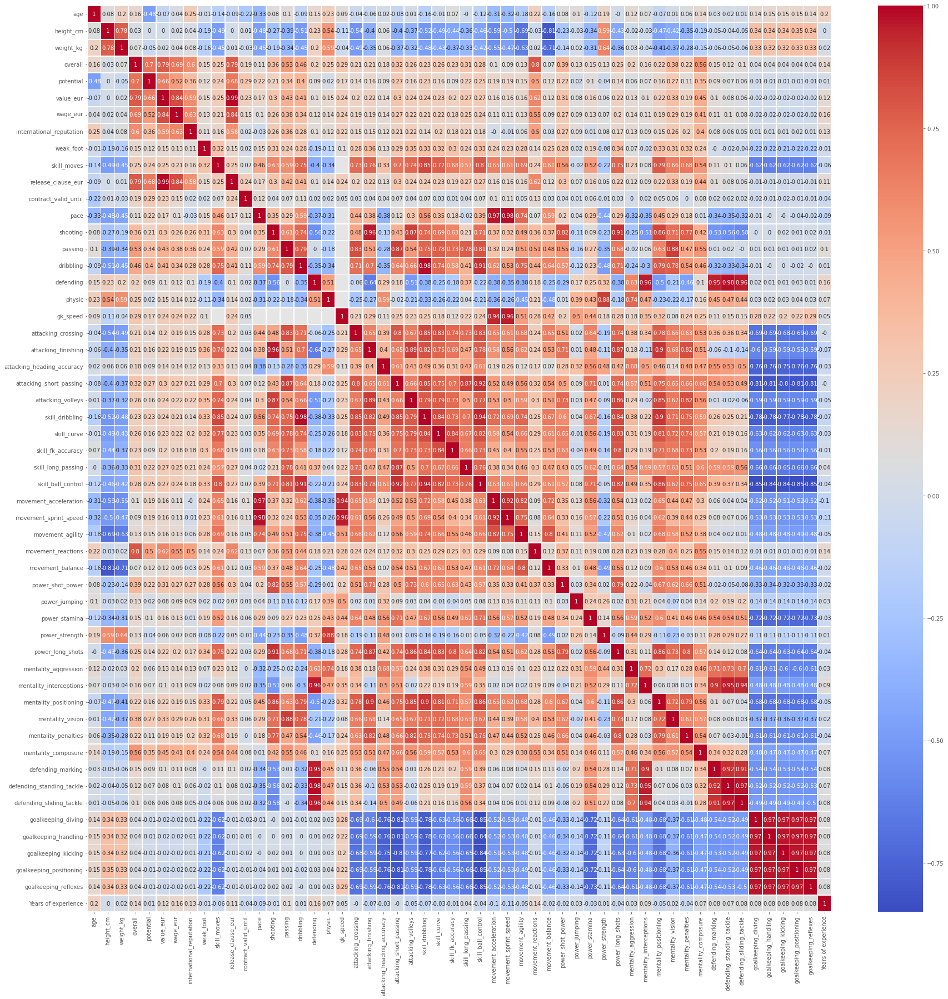

In [67]:
corr = df1.corr()
plt.figure(figsize=(30,30))
sns.heatmap(corr.round(2), annot=True, linecolor='white', linewidths=0.5, cmap='coolwarm')

In [68]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) >= threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr


In [69]:
corr_cols = correlation(df1, 0.85)
corr_cols

{'attacking_finishing',
 'attacking_short_passing',
 'attacking_volleys',
 'defending_marking',
 'defending_sliding_tackle',
 'defending_standing_tackle',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'movement_acceleration',
 'movement_sprint_speed',
 'power_long_shots',
 'power_strength',
 'release_clause_eur',
 'skill_ball_control',
 'skill_dribbling',
 'skill_long_passing'}

# Feature selection & Feature engineering

In [70]:
df_final = df1.copy()

In [71]:
# Lets first drop the highly correlated variables

In [72]:
df_final.drop(['attacking_finishing',
 'attacking_short_passing',
 'attacking_volleys',
 'defending_marking',
 'defending_sliding_tackle',
 'defending_standing_tackle',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'movement_acceleration',
 'movement_sprint_speed',
 'power_long_shots',
 'power_strength',
 'release_clause_eur',
 'skill_ball_control',
 'skill_dribbling',
 'skill_long_passing'], axis=1, inplace=True)

### Lets create a csv copy for our streamlit page

In [73]:
df_final.to_csv('streamlit_data.csv', index=False)

In [74]:
df_final.head(1)

,short_name,age,dob,height_cm,weight_kg,nationality,club,overall,potential,value_eur,wage_eur,player_positions,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,team_position,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,player_traits,attacking_crossing,attacking_heading_accuracy,skill_curve,skill_fk_accuracy,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,mentality_aggression,mentality_penalties,mentality_composure,goalkeeping_diving,Years of experience
0,L. Messi,32.0,1987-06-24,170.0,72.0,Argentina,FC Barcelona,94.0,94.0,95500000.0,565000.0,"RW, CF, ST",Left,5.0,4.0,4.0,Medium/Low,Messi,Yes,RW,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,"Beat Offside Trap, Argues with Officials, Earl...",88.0,70.0,93.0,94.0,93.0,95.0,95.0,86.0,68.0,75.0,48.0,75.0,96.0,6.0,16


In [75]:
df_final = df_final.drop(['short_name', 'nationality','dob', 'club', 'real_face', 'team_position', 
                          'player_positions', 'player_traits'], axis = 1)

In [76]:
df_final.isnull().sum()

age                              1
height_cm                        1
weight_kg                        1
overall                          1
potential                        1
value_eur                        1
wage_eur                         1
preferred_foot                   1
international_reputation         1
weak_foot                        1
skill_moves                      1
work_rate                        1
body_type                        1
contract_valid_until           185
pace                          1023
shooting                      1023
passing                       1023
dribbling                     1023
defending                     1023
physic                        1023
gk_speed                      9858
attacking_crossing               1
attacking_heading_accuracy       1
skill_curve                      1
skill_fk_accuracy                1
movement_agility                 1
movement_reactions               1
movement_balance                 1
power_shot_power    

Lets now perform some feature engineering and perform One Hot Encoding on our categorical variables. We use OHE instead of label encoding as our categorical variables are nominal, if they were ordinal, we could use label encoding

In [77]:
#Get dummies
df_final1 = pd.get_dummies(df_final, drop_first=True)
df_final1.head(1)

,age,height_cm,weight_kg,overall,potential,value_eur,wage_eur,international_reputation,weak_foot,skill_moves,contract_valid_until,pace,shooting,passing,dribbling,defending,physic,gk_speed,attacking_crossing,attacking_heading_accuracy,skill_curve,skill_fk_accuracy,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,mentality_aggression,mentality_penalties,mentality_composure,goalkeeping_diving,Years of experience,preferred_foot_Right,work_rate_High/Low,work_rate_High/Medium,work_rate_Low/High,work_rate_Low/Low,work_rate_Low/Medium,work_rate_Medium/High,work_rate_Medium/Low,work_rate_Medium/Medium,body_type_C. Ronaldo,body_type_Courtois,body_type_Lean,body_type_Messi,body_type_Neymar,body_type_Normal,body_type_Shaqiri,body_type_Stocky
0,32.0,170.0,72.0,94.0,94.0,95500000.0,565000.0,5.0,4.0,4.0,2021.0,87.0,92.0,92.0,96.0,39.0,66.0,NaN,88.0,70.0,93.0,94.0,93.0,95.0,95.0,86.0,68.0,75.0,48.0,75.0,96.0,6.0,16,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0


In [78]:
df_final1.isnull().sum()/len(df) * 100

age                            0.009190
height_cm                      0.009190
weight_kg                      0.009190
overall                        0.009190
potential                      0.009190
value_eur                      0.009190
wage_eur                       0.009190
international_reputation       0.009190
weak_foot                      0.009190
skill_moves                    0.009190
contract_valid_until           1.700211
pace                           9.401709
shooting                       9.401709
passing                        9.401709
dribbling                      9.401709
defending                      9.401709
physic                         9.401709
gk_speed                      90.598291
attacking_crossing             0.009190
attacking_heading_accuracy     0.009190
skill_curve                    0.009190
skill_fk_accuracy              0.009190
movement_agility               0.009190
movement_reactions             0.009190
movement_balance               0.009190


In [79]:
# Drop gk_speed as nearly 90% of all values are NaNs and we can then drop the rows of the other remaining NaNs

In [80]:
df_final1.drop('gk_speed', axis = 1, inplace = True )

In [81]:
df_final1.dropna(axis = 0, inplace = True)

In [82]:
df_final1.isnull().sum()

age                           0
height_cm                     0
weight_kg                     0
overall                       0
potential                     0
value_eur                     0
wage_eur                      0
international_reputation      0
weak_foot                     0
skill_moves                   0
contract_valid_until          0
pace                          0
shooting                      0
passing                       0
dribbling                     0
defending                     0
physic                        0
attacking_crossing            0
attacking_heading_accuracy    0
skill_curve                   0
skill_fk_accuracy             0
movement_agility              0
movement_reactions            0
movement_balance              0
power_shot_power              0
power_jumping                 0
power_stamina                 0
mentality_aggression          0
mentality_penalties           0
mentality_composure           0
goalkeeping_diving            0
Years of

# Data Preprocessing

In [83]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, SCORERS
from sklearn.ensemble import RandomForestRegressor

In [84]:
model_data = df_final1.copy()

In [85]:
X = model_data.drop('overall', axis=1)
y = model_data['overall'].values

In [86]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [87]:
scaler = StandardScaler()

In [88]:
X_train_scaled = scaler.fit_transform(X_train)

In [89]:
X_test_scaled = scaler.transform(X_test)

# Model Building
## Lets instantiate a Linear Regression and predict without any model tuning to get base scores

In [90]:
lr = LinearRegression()

In [91]:
train_score = cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)

In [92]:
train_score = cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
train_scaled_score = cross_val_score(lr, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -1.9, the scaled training score is -2.558022304655942e+24


In [93]:
train_score = cross_val_score(lr, X_train, y_train, cv=5, scoring='r2').mean().round(2)
train_scaled_score = cross_val_score(lr, X_train_scaled, y_train, cv=5, scoring='r2').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is 0.91, the scaled training score is -1.2519871718649861e+23


In [94]:
train_score = cross_val_score(lr, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
train_scaled_score = cross_val_score(lr, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -1.08, the scaled training score is -20202983334.61


# Lasso Regression

In [95]:
Lasso = Lasso(random_state= 42)

In [96]:
train_score = cross_val_score(Lasso, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
train_scaled_score = cross_val_score(Lasso, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -2.41, the scaled training score is -4.88


In [97]:
train_score = cross_val_score(Lasso, X_train, y_train, cv=5, scoring='r2').mean().round(2)
train_scaled_score = cross_val_score(Lasso, X_train_scaled, y_train, cv=5, scoring='r2').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is 0.88, the scaled training score is 0.76


In [98]:
train_score = cross_val_score(Lasso, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
train_scaled_score = cross_val_score(Lasso, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -1.21, the scaled training score is -1.82


# Ridge Regression

In [99]:
ridge = Ridge(random_state=42)

In [100]:
train_score = cross_val_score(ridge, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
train_scaled_score = cross_val_score(ridge, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -1.9, the scaled training score is -1.9


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.32289e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.52932e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.44948e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.58766e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-condit

In [101]:
train_score = cross_val_score(ridge, X_train, y_train, cv=5, scoring='r2').mean().round(2)
train_scaled_score = cross_val_score(ridge, X_train_scaled, y_train, cv=5, scoring='r2').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.32289e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.52932e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


The training score is 0.91, the scaled training score is 0.91


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.44948e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.58766e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.50789e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T


In [102]:
train_score = cross_val_score(ridge, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
train_scaled_score = cross_val_score(ridge, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.32289e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.52932e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.44948e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-conditioned matrix (rcond=4.58766e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True, overwrite_a=True).T
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_ridge.py:157: LinAlgWarning: Ill-condit

The training score is -1.08, the scaled training score is -1.08


Between Ridge and Lasso, we can see that our base model ridge has a higher accuracy as it includes all coefficients whilst Lasso will remove some with low explanatory power

# Random Forest Regressor

In [103]:
rf = RandomForestRegressor(random_state=42)

In [104]:
train_score = cross_val_score(rf, X_train, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
train_scaled_score = cross_val_score(ridge, X_train_scaled, y_train, cv=5, scoring='neg_mean_squared_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -0.09, the scaled training score is -1.9


In [105]:
train_score = cross_val_score(rf, X_train, y_train, cv=5, scoring='r2').mean().round(2)
train_scaled_score = cross_val_score(rf, X_train_scaled, y_train, cv=5, scoring='r2').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is 1.0, the scaled training score is 1.0


In [106]:
train_score = cross_val_score(rf, X_train, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
train_scaled_score = cross_val_score(rf, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean().round(2)
print('The training score is {}, the scaled training score is {}'.format(train_score, train_scaled_score))

The training score is -0.17, the scaled training score is -0.17


In [107]:
# We will not use the scaled data as the unscaled data provides better results